In [1]:
import numpy as np
import pandas as pd
import optuna
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import roc_auc_score
from lightgbm import LGBMClassifier

# Загрузим данные

- Данные упорядочены по времени
- Задача - предсказать `target`
- Фичи - `feature_i`
- Трейн, валидация и тест уже определены (см. колонку `sample_part`)

In [2]:
df = pd.read_parquet('df.parquet.gzip')
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 500000 entries, 22620 to 310653
Columns: 235 entries, date to sample_part
dtypes: category(2), datetime64[ms](1), datetime64[ns](2), float64(220), int64(9), object(1)
memory usage: 893.6+ MB


In [3]:
df.head()

,date,month,quarter,feature_217,feature_66,feature_9,feature_193,feature_15,feature_199,feature_25,...,feature_20,feature_188,feature_71,feature_106,feature_14,feature_92,feature_179,feature_102,target,sample_part
22620,2021-01-01,2021-01-01,2021-01-01,1.180855,0.483118,13.976791,1.135021,43.271792,-46.888875,97.558366,...,23.745198,-32.001093,85.489903,1.454045,-195.725786,3.719083,1,-28.813537,0.0,train
478621,2021-01-01,2021-01-01,2021-01-01,3.427814,0.886778,27.158209,-0.378728,80.087863,-67.242703,105.803406,...,22.902111,-37.436243,71.735619,1.657242,-176.250404,3.277817,1,-45.987721,1.0,train
372254,2021-01-01,2021-01-01,2021-01-01,-38.555018,1.227175,19.893873,0.498787,98.464365,-67.402522,81.858076,...,21.848414,-51.872841,65.363236,1.626874,-178.116798,2.028950,0,-31.074122,1.0,train
2596,2021-01-01,2021-01-01,2021-01-01,-14.666558,0.753129,18.203010,-1.200014,117.331340,-25.557745,90.277266,...,26.134586,-49.703003,65.013659,1.170023,-192.232264,2.218177,1,-36.703897,0.0,train
216892,2021-01-01,2021-01-01,2021-01-01,6.734990,1.129100,11.245920,-0.108955,61.205722,-78.397406,82.637472,...,24.201039,-41.070219,69.986127,1.630795,-200.155528,3.055104,1,-44.672299,1.0,train


In [8]:
TARGET = 'target'
N_FEATURES = 230
features = [f'feature_{i}' for i in range(N_FEATURES)]

# Первичный отбор признаков... (1 балл)

**Задание:** Сначала отсеем совсем уж мусорные признаки.

Воспользовавшись вашим кодом для вычисления `IV` из прошлой домашки, для всех **числовых** фичей вычислите `IV` на 20 бакетах. Отсейте признаки с `IV < 0.005`.

**Hint:** паркет не всегда сохраняет `dtype` колонки. Чтобы проверить признаки на "реальный" тип данных, лучше на всякий случай посмотреть на `nunique` 

In [45]:
# your code here
df_train = df[df["sample_part"] == "train"].copy()
y = df_train[TARGET].astype(int).values
num_features = []
cat_features = []
for col in features:
    if col not in df_train.columns:
        missing_features.append(col)
        continue

    s = df_train[col]
    if str(s.dtype) in ("object", "category", "bool"):
        cat_features.append(col)
        continue
    x = pd.to_numeric(s, errors="coerce")
    if x.isna().mean() > 0.95:
        cat_features.append(col)
        continue
    if x.nunique(dropna=True) < 20:
        cat_features.append(col)
        continue
    num_features.append(col)

print("Всего features:", len(features))
print("num_features:", len(num_features))
print("cat_features:", len(cat_features))

Всего features: 230
num_features: 216
cat_features: 14


In [46]:
def calc_buckets(x : Union[np.ndarray, pd.Series], n_buckets : int) -> np.ndarray:
    """Разбивает массив значений признака x на 
    n_buckets бакетов"""

    x = pd.Series(x).reset_index(drop=True)
    buckets = x.rank(method="dense", pct=True) * n_buckets
    buckets = np.ceil(buckets) - 1
    buckets = np.array(buckets, dtype=np.int16)

    return buckets


def calc_iv_feature(x, y, n_buckets=20):
    buckets = calc_buckets(x, n_buckets)

    t = pd.DataFrame({"b": buckets, "y": y}).groupby("b")["y"]
    B_i = t.sum().values
    N_i = t.size().values
    G_i = N_i - B_i
    B = B_i.sum()
    G = G_i.sum()
    eps = 1e-6
    b_i = (B_i + eps) / (B + eps * len(B_i))
    g_i = (G_i + eps) / (G + eps * len(G_i))
    woe = np.log(b_i / g_i)
    iv = float(np.sum((b_i - g_i) * woe))
    return iv

In [56]:
import warnings
warnings.filterwarnings('ignore')

ivs = np.zeros(len(numeric_features))

for i, col in enumerate(numeric_features):
    x = pd.to_numeric(df_train[col], errors="coerce").values
    ivs[i] = calc_iv_feature(x, y, n_buckets=20)

good_num_features = np.array(numeric_features)[ivs >= 0.005].tolist()
bad_num_features  = np.array(numeric_features)[ivs <  0.005].tolist()

print("числовых фич:", len(numeric_features))
print("оставил:", len(good_features))
print("выкинул:", len(bad_features))

числовых фич: 216
оставил: 57
выкинул: 159


**Вопрос**: Почему некорректно сравнивать `IV` у категориальных и числовых фичей?

Вычислите IV для категориальных фичей на `n` бакетах, где `n = min(число категорий фичи, 20)`. Возможно, придётся перекодировать некоторые фичи (*только не OneHot-ом!*)

*Опционально*: примените также и к категориальным фичам предварительный отбор по `IV` с менее строгим порогом

Ответ: потому что IV считается по бакетам, а у числовых и категориальных признаки разные разбиения

In [54]:
def iv_categorical_feature(x, y, max_buckets=20):
    s = pd.Series(x).astype("object").fillna("__MISSING__")

    cats = s.unique()
    k = len(cats)
    n = min(k, max_buckets)

    if k <= max_buckets:
        bucket_map = {c: i for i, c in enumerate(cats)}
        buckets = s.map(bucket_map).values
        return calc_iv_feature(buckets, y), n
    tmp = pd.DataFrame({"cat": s.values, "y": y})
    stats = tmp.groupby("cat")["y"].agg(["mean", "size"]).reset_index()
    stats = stats.sort_values("mean", kind="mergesort").reset_index(drop=True)

    stats["bucket"] = np.floor(np.linspace(0, n, len(stats), endpoint=False)).astype(int)
    cat2bucket = dict(zip(stats["cat"], stats["bucket"]))

    buckets = s.map(cat2bucket).values
    return calc_iv_feature(buckets, y), n

In [55]:
cat_ivs = np.zeros(len(cat_features))
cat_nb  = np.zeros(len(cat_features), dtype=int)

for i, col in enumerate(cat_features):
    iv, n_used = iv_categorical_feature(df_train[col].values, y, max_buckets=20)
    cat_ivs[i] = iv
    cat_nb[i]  = n_used

top_idx = np.argsort(cat_ivs)[::-1][:20]
[(cat_features[i], float(cat_ivs[i]), int(cat_nb[i])) for i in top_idx]

[('feature_209', 0.02473347515879035, 3),
 ('feature_144', 0.012915268939621784, 2),
 ('feature_31', 0.011659488630728923, 3),
 ('feature_10', 0.011093508035292297, 3),
 ('feature_147', 0.008894030175393999, 2),
 ('feature_165', 0.008577581169248427, 2),
 ('feature_168', 0.006602342413626995, 2),
 ('feature_62', 0.006219246626059324, 3),
 ('feature_161', 0.0022208322064341712, 3),
 ('feature_0', 0.0008149385024535024, 4),
 ('feature_157', 0.0002790311495752176, 13),
 ('feature_37', 0.00015409132689688752, 12),
 ('feature_179', 1.923131139827825e-06, 2),
 ('feature_222', 6.633918805267925e-09, 2)]

In [57]:
good_cat_features = np.array(cat_features)[cat_ivs >= 0.001].tolist()
bad_cat_features  = np.array(cat_features)[cat_ivs <  0.001].tolist()

print("всего категориальных:", len(cat_features))
print("оставили:", len(good_cat_features))
print("выкинули:", len(bad_cat_features))

всего категориальных: 14
оставили: 9
выкинули: 5


# Бустинг

## Подбор гиперпараметров бустинга (3 балла)

Теперь подберем оптимальные гиперпараметры бустинга.

In [58]:
# В переменную features_optuna положите список признаков с предыдущего шага
features_optuna = good_features + good_cat_features

**Задание:** Заполните пропуски в коде ниже и подберите оптимальные гиперпараметры.

Для успешного решения необходимо преодолеть порог ROC-AUC `0.725` на тестовой выборке.

In [71]:
def objective(trial):
    params = {
        "learning_rate": trial.suggest_float("learning_rate", 0.02, 0.15, log=True),
        "num_leaves": trial.suggest_int("num_leaves", 64, 256),
        "max_depth": trial.suggest_int("max_depth", 6, 12),
        "min_child_samples": trial.suggest_int("min_child_samples", 50, 250),
        "subsample": trial.suggest_float("subsample", 0.6, 0.9),
        "subsample_freq": trial.suggest_int("subsample_freq", 1, 10),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, 0.9),
        "reg_alpha": trial.suggest_float("reg_alpha", 1e-6, 1.0, log=True),
        "reg_lambda": trial.suggest_float("reg_lambda", 1e-3, 10.0, log=True),
        "n_estimators": 5000,
        "max_bin": 63,
        "objective": "binary",
        "random_state": 42,
        "n_jobs": -1,
        "verbosity": -1
    }
    
    # params = {
    #     "learning_rate": trial.suggest_float("learning_rate", 1e-3, 0.2, log=True),
    #     "num_leaves": trial.suggest_int("num_leaves", 16, 256),
    #     "n_estimators": trial.suggest_int("n_estimators", 300, 3000),
    #     "max_depth": trial.suggest_int("max_depth", -1, 12),
    #     "min_child_samples": trial.suggest_int("min_child_samples", 5, 200),
    #     "subsample": trial.suggest_float("subsample", 0.6, 1.0),
    #     "subsample_freq": trial.suggest_int("subsample_freq", 1, 10),
    #     "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, 1.0),
    #     "reg_alpha": trial.suggest_float("reg_alpha", 1e-8, 10.0, log=True),
    #     "reg_lambda": trial.suggest_float("reg_lambda", 1e-8, 10.0, log=True),
    #     "objective": "binary",
    #     "random_state": 42,
    #     "n_jobs": -1,
    # }
    
    clf = LGBMClassifier(**params)
    clf.fit(
        X=df.loc[df['sample_part'] == 'train', features_optuna],
        y=df.loc[df['sample_part'] == 'train', TARGET]
    )
    preds = clf.predict_proba(df.loc[df['sample_part'] == 'val', features_optuna])[:, 1]
    auc_valid = roc_auc_score(
        y_true=df.loc[df['sample_part'] == 'val', TARGET],
        y_score=preds
    )
    
    return auc_valid

In [64]:
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)

[I 2026-02-08 20:40:15,335] A new study created in memory with name: no-name-ecffc16b-3349-41e3-a196-4fb64aa16fee


[LightGBM] [Info] Number of positive: 177320, number of negative: 72680
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.032181 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14356
[LightGBM] [Info] Number of data points in the train set: 250000, number of used features: 66
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.709280 -> initscore=0.891890
[LightGBM] [Info] Start training from score 0.891890
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

[I 2026-02-08 20:42:00,549] Trial 0 finished with value: 0.7582240330257406 and parameters: {'learning_rate': 0.01105682029932983, 'num_leaves': 256, 'n_estimators': 1962, 'max_depth': 12, 'min_child_samples': 192, 'subsample': 0.6041401627699112, 'subsample_freq': 2, 'colsample_bytree': 0.8917731654783971, 'reg_alpha': 5.7839765201760714e-06, 'reg_lambda': 1.171489318636123e-06}. Best is trial 0 with value: 0.7582240330257406.


[LightGBM] [Info] Number of positive: 177320, number of negative: 72680
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.033455 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14356
[LightGBM] [Info] Number of data points in the train set: 250000, number of used features: 66
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.709280 -> initscore=0.891890
[LightGBM] [Info] Start training from score 0.891890
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

[I 2026-02-08 20:43:49,329] Trial 1 finished with value: 0.7544821112190383 and parameters: {'learning_rate': 0.00845282231873226, 'num_leaves': 200, 'n_estimators': 2062, 'max_depth': 11, 'min_child_samples': 187, 'subsample': 0.7736004003430274, 'subsample_freq': 9, 'colsample_bytree': 0.7263382347878472, 'reg_alpha': 0.00022431424260859744, 'reg_lambda': 1.2083510532542583}. Best is trial 0 with value: 0.7582240330257406.


[LightGBM] [Info] Number of positive: 177320, number of negative: 72680
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.034908 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14356
[LightGBM] [Info] Number of data points in the train set: 250000, number of used features: 66
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.709280 -> initscore=0.891890
[LightGBM] [Info] Start training from score 0.891890
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

[I 2026-02-08 20:43:58,747] Trial 2 finished with value: 0.6660455182127245 and parameters: {'learning_rate': 0.006416104286888598, 'num_leaves': 181, 'n_estimators': 979, 'max_depth': 2, 'min_child_samples': 44, 'subsample': 0.6753880688296333, 'subsample_freq': 4, 'colsample_bytree': 0.9107937571968926, 'reg_alpha': 1.5993142487941416e-06, 'reg_lambda': 3.244023377278593e-05}. Best is trial 0 with value: 0.7582240330257406.


[LightGBM] [Info] Number of positive: 177320, number of negative: 72680
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.032594 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14356
[LightGBM] [Info] Number of data points in the train set: 250000, number of used features: 66
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.709280 -> initscore=0.891890
[LightGBM] [Info] Start training from score 0.891890
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

[I 2026-02-08 20:45:40,706] Trial 3 finished with value: 0.7359026886838272 and parameters: {'learning_rate': 0.0027088665562072893, 'num_leaves': 233, 'n_estimators': 2372, 'max_depth': 8, 'min_child_samples': 87, 'subsample': 0.7214303842401415, 'subsample_freq': 8, 'colsample_bytree': 0.7668051563153157, 'reg_alpha': 6.754078299161885e-08, 'reg_lambda': 0.009410047719972711}. Best is trial 0 with value: 0.7582240330257406.


[LightGBM] [Info] Number of positive: 177320, number of negative: 72680
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.041672 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14356
[LightGBM] [Info] Number of data points in the train set: 250000, number of used features: 66
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.709280 -> initscore=0.891890
[LightGBM] [Info] Start training from score 0.891890


[I 2026-02-08 20:46:39,270] Trial 4 finished with value: 0.7549442044681884 and parameters: {'learning_rate': 0.06700864427830722, 'num_leaves': 128, 'n_estimators': 1634, 'max_depth': 0, 'min_child_samples': 63, 'subsample': 0.7941891291008825, 'subsample_freq': 10, 'colsample_bytree': 0.6384501052065212, 'reg_alpha': 3.4460040693572527, 'reg_lambda': 3.217137013249303}. Best is trial 0 with value: 0.7582240330257406.


[LightGBM] [Info] Number of positive: 177320, number of negative: 72680
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030010 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14356
[LightGBM] [Info] Number of data points in the train set: 250000, number of used features: 66
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.709280 -> initscore=0.891890
[LightGBM] [Info] Start training from score 0.891890
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

[I 2026-02-08 20:47:32,025] Trial 5 finished with value: 0.7562464735308403 and parameters: {'learning_rate': 0.025589902648232406, 'num_leaves': 134, 'n_estimators': 1604, 'max_depth': 12, 'min_child_samples': 96, 'subsample': 0.6939775860953049, 'subsample_freq': 7, 'colsample_bytree': 0.6545316537125648, 'reg_alpha': 0.00582767943823426, 'reg_lambda': 0.02737309189509733}. Best is trial 0 with value: 0.7582240330257406.


[LightGBM] [Info] Number of positive: 177320, number of negative: 72680
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.032229 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14356
[LightGBM] [Info] Number of data points in the train set: 250000, number of used features: 66
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.709280 -> initscore=0.891890
[LightGBM] [Info] Start training from score 0.891890
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

[I 2026-02-08 20:48:12,555] Trial 6 finished with value: 0.7511665716367169 and parameters: {'learning_rate': 0.11293755211166849, 'num_leaves': 222, 'n_estimators': 2053, 'max_depth': 4, 'min_child_samples': 71, 'subsample': 0.9013826656232806, 'subsample_freq': 6, 'colsample_bytree': 0.7158559702118094, 'reg_alpha': 0.043435771368802965, 'reg_lambda': 7.374063710061576e-05}. Best is trial 0 with value: 0.7582240330257406.


[LightGBM] [Info] Number of positive: 177320, number of negative: 72680
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.019619 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 14356
[LightGBM] [Info] Number of data points in the train set: 250000, number of used features: 66
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.709280 -> initscore=0.891890
[LightGBM] [Info] Start training from score 0.891890


[I 2026-02-08 20:49:03,443] Trial 7 finished with value: 0.7050619169499756 and parameters: {'learning_rate': 0.0015512266148205458, 'num_leaves': 137, 'n_estimators': 839, 'max_depth': 9, 'min_child_samples': 27, 'subsample': 0.6342745071737307, 'subsample_freq': 2, 'colsample_bytree': 0.9961842669952945, 'reg_alpha': 0.011302846602340249, 'reg_lambda': 2.7781320979124793}. Best is trial 0 with value: 0.7582240330257406.


[LightGBM] [Info] Number of positive: 177320, number of negative: 72680
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.032389 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14356
[LightGBM] [Info] Number of data points in the train set: 250000, number of used features: 66
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.709280 -> initscore=0.891890
[LightGBM] [Info] Start training from score 0.891890


[W 2026-02-08 20:49:11,938] Trial 8 failed with parameters: {'learning_rate': 0.0142020364344684, 'num_leaves': 209, 'n_estimators': 1148, 'max_depth': 0, 'min_child_samples': 78, 'subsample': 0.8535740429112547, 'subsample_freq': 3, 'colsample_bytree': 0.9416285492260632, 'reg_alpha': 1.019190346554326, 'reg_lambda': 0.00010271517159419685} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "/opt/anaconda3/envs/myenv/lib/python3.12/site-packages/optuna/study/_optimize.py", line 205, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "/var/folders/z_/d0y9gfdn1w5475vgs7zb15ph0000gn/T/ipykernel_8971/2915872988.py", line 19, in objective
    clf.fit(
  File "/opt/anaconda3/envs/myenv/lib/python3.12/site-packages/lightgbm/sklearn.py", line 1560, in fit
    super().fit(
  File "/opt/anaconda3/envs/myenv/lib/python3.12/site-packages/lightgbm/sklearn.py", line 1049, in fit
    self._Booster = train(
            

KeyboardInterrupt: 

In [67]:
study2 = optuna.create_study(direction='maximize')
study2.optimize(objective, n_trials=50)

[I 2026-02-08 20:51:38,361] A new study created in memory with name: no-name-385e60e3-e022-4e20-be54-cea66a8af672
[I 2026-02-08 20:54:00,760] Trial 0 finished with value: 0.752468790675085 and parameters: {'learning_rate': 0.0770942289126814, 'num_leaves': 135, 'max_depth': 9, 'min_child_samples': 68, 'subsample': 0.6319340326739011, 'subsample_freq': 5, 'colsample_bytree': 0.6177148531117742, 'reg_alpha': 0.0102804653661483, 'reg_lambda': 0.07373455780023785}. Best is trial 0 with value: 0.752468790675085.
[I 2026-02-08 20:57:05,974] Trial 1 finished with value: 0.7571912302088393 and parameters: {'learning_rate': 0.02830919526770487, 'num_leaves': 160, 'max_depth': 8, 'min_child_samples': 66, 'subsample': 0.7871523593374589, 'subsample_freq': 8, 'colsample_bytree': 0.8204763282842413, 'reg_alpha': 0.014183123684342519, 'reg_lambda': 0.8732924398005831}. Best is trial 1 with value: 0.7571912302088393.
[I 2026-02-08 20:58:52,382] Trial 2 finished with value: 0.7546343084021369 and para

KeyboardInterrupt: 

In [73]:
best_params = {'learning_rate': 0.00845282231873226, 
               'num_leaves': 200, 
               'n_estimators': 2062, 
               'max_depth': 11, 
               'min_child_samples': 187, 
               'subsample': 0.7736004003430274, 
               'subsample_freq': 9, 
               'colsample_bytree': 0.7263382347878472, 
               'reg_alpha': 0.00022431424260859744, 
               'reg_lambda': 1.2083510532542583,
               "objective": "binary",
               "random_state": 42,
               "n_jobs": -1,}
# print(study.best_params)

In [74]:
clf = LGBMClassifier(**best_params)
clf.fit(
    X=df.loc[df['sample_part'] == 'train', features_optuna],
    y=df.loc[df['sample_part'] == 'train', TARGET]
)

preds_test = clf.predict_proba(df.loc[df['sample_part'] == 'test', features_optuna])[:, 1]
auc_test = roc_auc_score(
    y_true=df.loc[df['sample_part'] == 'test', TARGET],
    y_score=preds_test
)
assert auc_test > 0.725, f'Необходимое значение ROC-AUC 0.725 и выше, ваше значение: {auc_test}!'

In [75]:
auc_test

np.float64(0.7412740491801095)

## Кривые накопления (2 балла)

**Задание:** Отрисуйте кривые накопления `ROC AUC` от `n_estimators` для бустинга с гиперпараметрами из предыдущего пункта.

**Hint:** для получения auc на каждой итерации обучения `LGBMClassifier`, можно воспользоваться параметрами `eval_set`, `eval_metric` и в методе `fit`. 

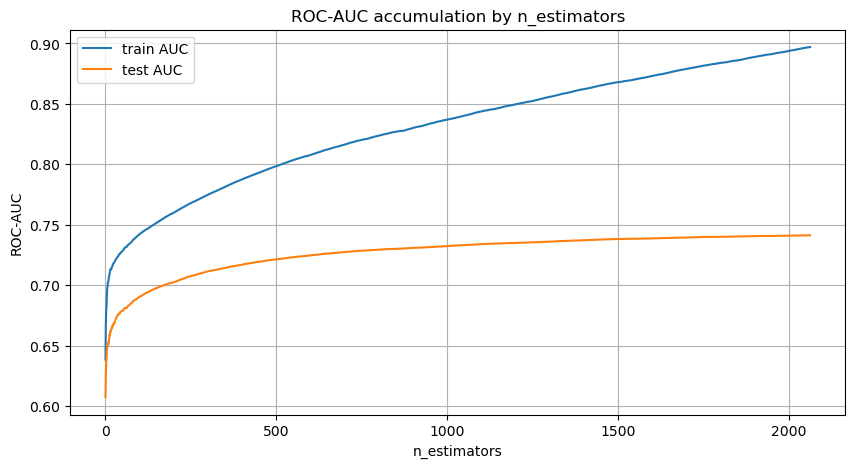

In [79]:
from lightgbm import record_evaluation

df_train = df[df['sample_part'] == 'train']
df_test = df[df['sample_part'] == 'test']

X_train = df_train[features_optuna]
y_train = df_train[TARGET].astype(int)

X_test = df_test[features_optuna]
y_test = df_test[TARGET].astype(int)

evals_result = {}

clf = LGBMClassifier(**best_params)
clf.fit(X_train, y_train, eval_set=[(X_train, y_train), (X_test, y_test)], eval_names=['train', 'test'], eval_metric='auc', callbacks=[record_evaluation(evals_result)])

auc_train = evals_result['train']['auc']
auc_test = evals_result['test']['auc']
iters = range(1, len(auc_train) + 1)

plt.figure(figsize=(10, 5))
plt.plot(iters, auc_train, label='train AUC')
plt.plot(iters, auc_test, label='test AUC')
plt.xlabel('n_estimators')
plt.ylabel('ROC-AUC')
plt.title('ROC-AUC accumulation by n_estimators')
plt.legend()
plt.grid(True)
plt.show()

**Вопрос:** Что вы видите на полученных графиках? 

Нужно ли "обрезать" количество деревьев? Ответ обоснуйте.

ROC-AUC на тестовой выборке выходит на плато после 400-600 деревьев. Это может говорить о постепенном переобучении модели, эффективное число деревьев меньше заданного значения n_estimators. Дополнительные итерации дают незначительный прирост обобщающей способности.

После 400–600 деревьев прирост ROC-AUC на тесте минимален, дальнейшее увеличение n_estimators может привести к переобучению.

## Важность признаков (1 балл)

**Задание:** Постойте гистограмму важности признаков по `split` и `gain` для бустинга из предыдущего пункта.

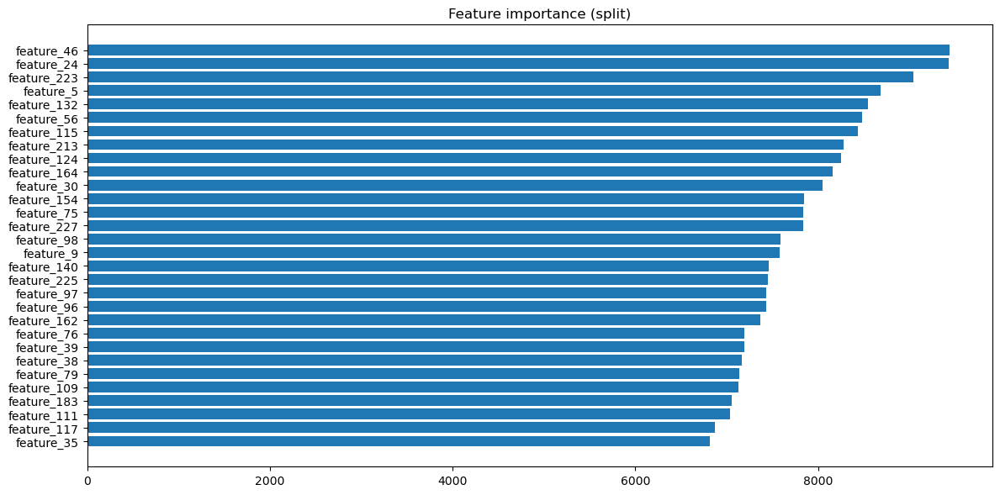

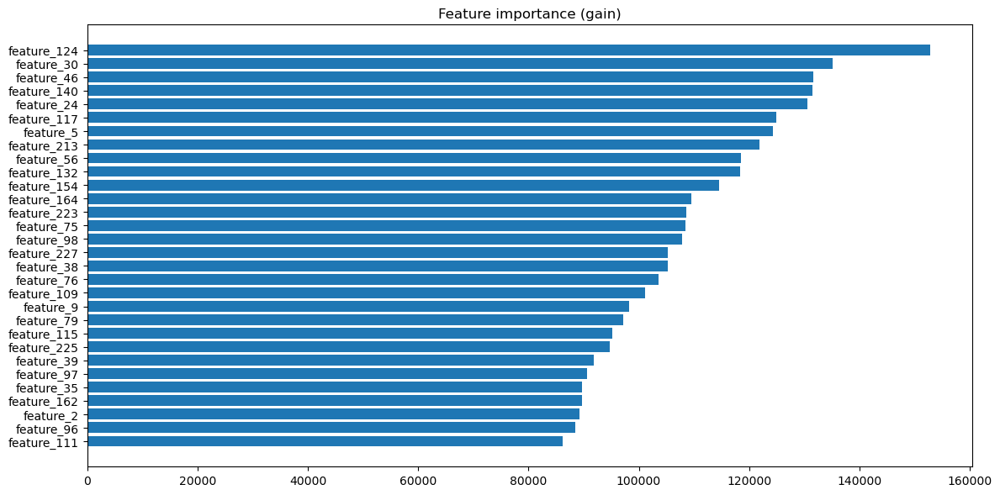

In [83]:
booster = clf.booster_
imp_split = booster.feature_importance(importance_type='split')
imp_gain = booster.feature_importance(importance_type='gain')
imp = pd.DataFrame({'feature': features_optuna, 'split': imp_split, 'gain': imp_gain})
top = 30
imp_split_top = imp.sort_values('split', ascending=False).head(top).sort_values('split')
imp_gain_top  = imp.sort_values('gain',  ascending=False).head(top).sort_values('gain')

plt.figure(figsize=(12,6))
plt.barh(imp_split_top['feature'], imp_split_top['split'])
plt.title('Feature importance (split)')
plt.tight_layout()
plt.show()

plt.figure(figsize=(12,6))
plt.barh(imp_gain_top['feature'], imp_gain_top['gain'])
plt.title('Feature importance (gain)')
plt.tight_layout()
plt.show()

**Вопрос:** Какие выводы можно сделать из полученных графиков?

По графикам видно, что важности признаков по split и по gain различаются. Модель опирается на относительно небольшой набор действительно сильных признаков: по gain несколько фич дают больший вклад в качество, чем остальные. По split многие признаки используются часто.

# Логрег

## plot_metric_time (1 балл)

**Задание:** Реализуйте функцию plot_metric_time, которая будет принимать на вход четыре аргумента, а именно: 
- массив значений фичи, 
- массив значений таргета,
- массив времени (аггрегированного по месяцам или кварталам, то есть `month` или `quarter` в вашей задаче, по дням рисовать не надо),
- метрику, которую необходимо отрисовать (нужно реализовать функцию для двух метрик: `IV` и `roc_auc`)
- число бакетов для вычисления `IV`, если выбрана эта метрика

Можете добваить какие-то ещё аргументы, если вам нужно

Если в фиче есть пропуски, функция должна убирать строки с пропусками из рассмотрения

**Hint**: можно, конечно, реализовать эту функцию через цикл, а можно попробовать разобраться и реализовать её через пандасовские `groupby` -> `apply`, это изящнее и быстрее

In [86]:
import plotly.graph_objects as go

In [111]:
def plot_metric_time(
        values: pd.Series,
        target: pd.Series,
        time: pd.Series,
        metric: str = 'IV',
        n_buckets_for_IV: int = 15
) -> go.Figure:

    df = pd.DataFrame({
        'x': values,
        'y': target,
        't': time
    }).dropna()
    times = np.sort(df['t'].unique())
    metric_values = []
    if metric == 'IV':
        for tt in times:
            d = df[df['t'] == tt]
            x = d['x'].values
            y = d['y'].values.astype(int)

            if len(np.unique(y)) < 2:
                metric_values.append(np.nan)
                continue

            q = min(n_buckets_for_IV, pd.Series(x).nunique())
            if q < 2:
                metric_values.append(np.nan)
                continue

            buckets = pd.qcut(x, q=q, duplicates='drop')
            stat = pd.DataFrame({'b': buckets, 'y': y}).groupby('b')['y'].agg(['sum', 'count'])

            B = y.sum()
            G = len(y) - B
            if B == 0 or G == 0:
                metric_values.append(np.nan)
                continue

            bad = stat['sum'].values
            good = stat['count'].values - bad

            eps = 1e-6
            br = (bad + eps) / (B + eps)
            gr = (good + eps) / (G + eps)

            iv = np.sum((br - gr) * np.log(br / gr))
            metric_values.append(iv)

    elif metric == 'roc_auc':
        for tt in times:
            d = df[df['t'] == tt]
            x = d['x'].values
            y = d['y'].values.astype(int)

            if len(np.unique(y)) < 2:
                metric_values.append(np.nan)
                continue

            metric_values.append(roc_auc_score(y, x))

    else:
        raise NotImplementedError("only 'IV' and 'roc_auc' metrics are implemented")

    feature_name = values.name if values.name is not None else 'feature'
    plot_title = f'{feature_name}, {metric} in time'

    fig = go.Figure()
    fig.add_trace(
        go.Scatter(
            x=times,
            y=metric_values,
            mode='markers+lines',
            name=feature_name
        )
    )
    fig.update_layout(
        title_text=plot_title,
        yaxis=dict(title=metric),
        width=1000,
        height=450,
        xaxis=dict(
            domain=[0, .95],
            showgrid=True,
            tickvals=times
        ),
        margin=dict(l=30, r=30, b=30, t=50),
    )
    # fig.show()

    return fig

    # return fig

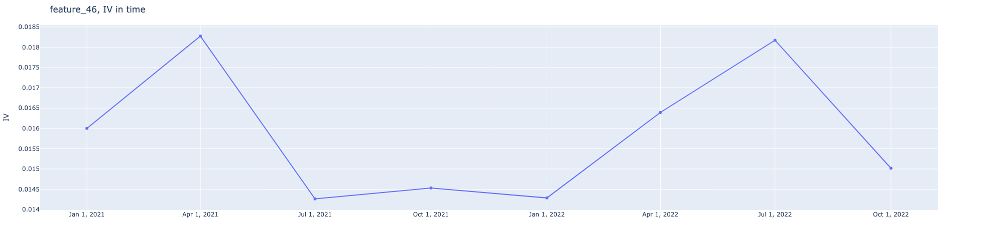

In [113]:
plot_metric_time(values=df['feature_46'],target=df['target'],time=df['quarter'],metric='IV',n_buckets_for_IV=20)

In [15]:
# примерно так это должно будет выглядеть
plot_metric_time(df[...], df['target'], df['quarter']) # 

**Задание:** Возьмите **топ-15** фичей получившегося бустинга по важности по `gain`. Отрисуйте для них графики стабильности по `IV` во времени и удалите из рассмотрения те признаки, качество которых деградирует

**NB!** Обращайте внимание на масштаб оси *y!* Иногда признак стабильнее, чем кажется)

Если вам это мешает, можете поменять ось *y*, чтобы она начиналась от нуля в прошлом задании.

In [119]:
# your code here
booster = clf.booster_

imp = pd.DataFrame({'feature': features_optuna, 'gain': booster.feature_importance(importance_type='gain')})

top15_features = imp.sort_values('gain', ascending=False).head(15)['feature'].tolist()
top15_features

['feature_124',
 'feature_30',
 'feature_46',
 'feature_140',
 'feature_24',
 'feature_117',
 'feature_5',
 'feature_213',
 'feature_56',
 'feature_132',
 'feature_154',
 'feature_164',
 'feature_223',
 'feature_75',
 'feature_98']

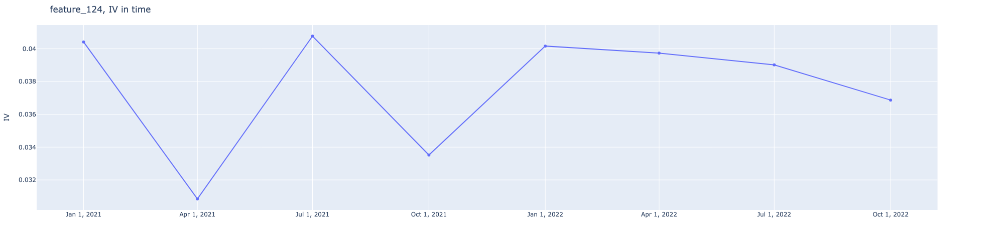

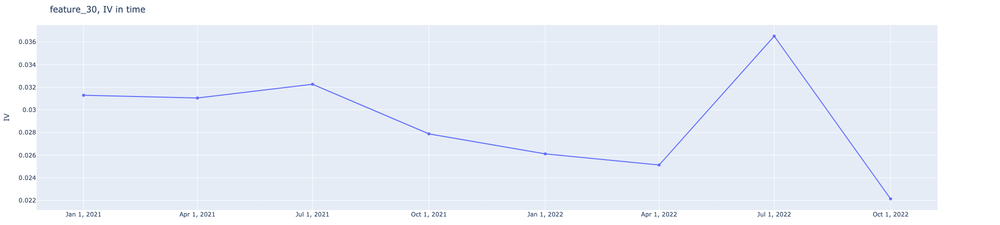

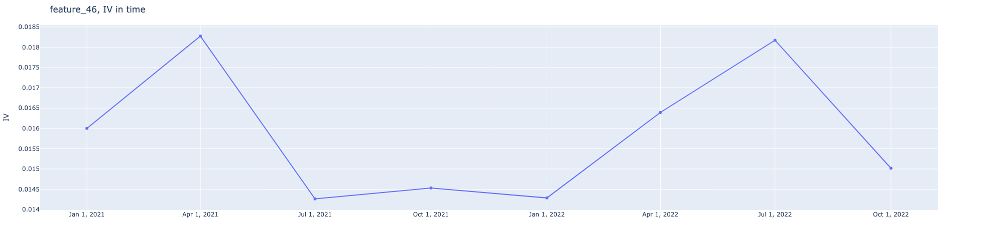

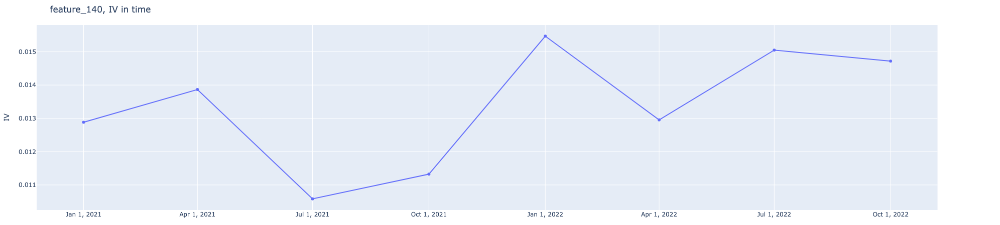

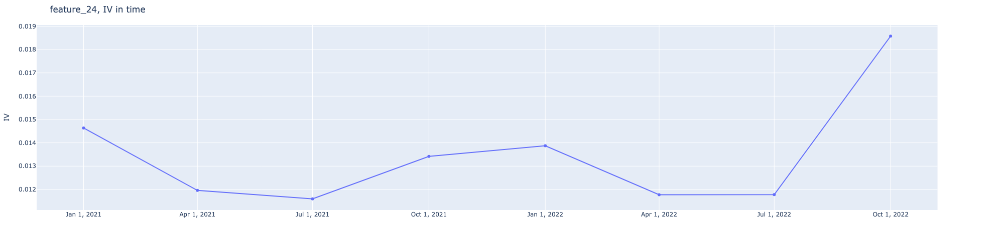

...

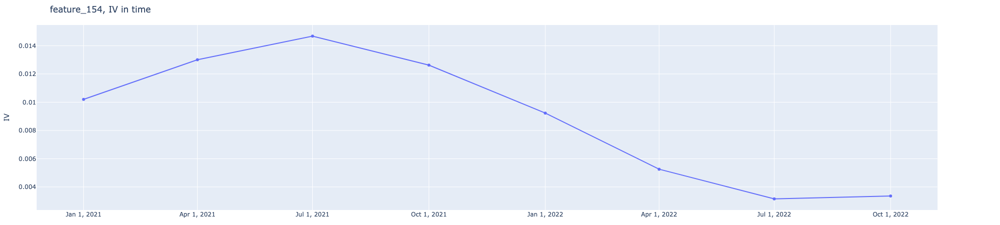

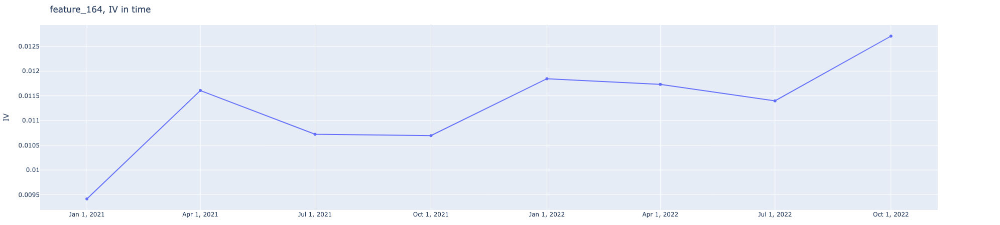

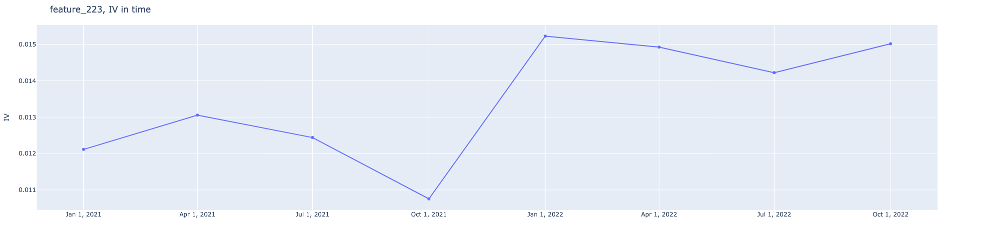

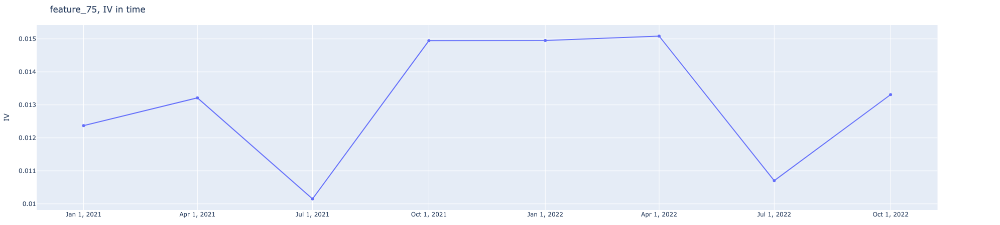

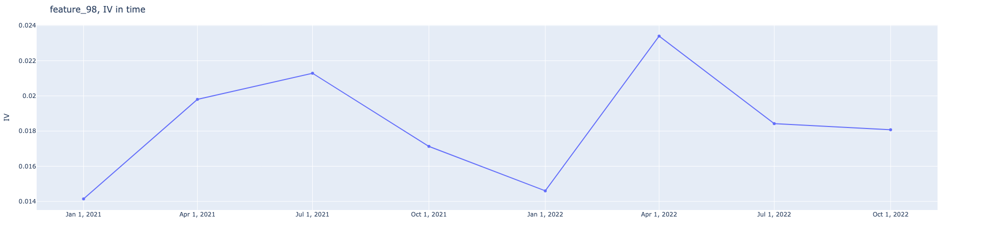

In [120]:
for f in top15_features:
    fig = plot_metric_time(values=df[f], target=df['target'], time=df['quarter'], metric='IV',n_buckets_for_IV=20)
    fig.show()

Исключить: 30, 117, 5, 213, 132, 154, 

In [122]:
exclude = {30, 117, 5, 213, 132, 154}

top15features_stable = [f for f in top15_features if int(f.split('_')[1]) not in exclude]

На этом моменте предлагаю сделать новый маленький датафрейм, чтобы не "портить" исходный

И проводить все манипуляции с фичами на нём

In [126]:
df_for_logreg = df[top15features_stable + ['date', 'month', 'quarter', 'target', 'sample_part']]
df_for_logreg.columns

Index(['feature_124', 'feature_46', 'feature_140', 'feature_24', 'feature_56',
       'feature_164', 'feature_223', 'feature_75', 'feature_98', 'date',
       'month', 'quarter', 'target', 'sample_part'],
      dtype='object')

## Предобработка признаков (3 балла)

**Задание:** Используя функицю woe_line из предыдущего ДЗ, проверьте **числовые** фичи из полученного списка фичей на линейность по WoE на трейн-выборке (если в фиче есть пропуски - дропаем их при отрисовке)

Если фичи нелинейные, **линеаризуйте их**.

Преобразования, которые можно/стоит пробовать:
- клипы (`np.clip`) - зачастую их достаточно
- корень
- квадрат
- логарифм

Если нужно, можно прибавлять к фиче константу или менять её знак

При желании можно "распилить фичу на две половины" (если она немонотонна) и линеаризовать их по отдельности

Однако слишком упираться в линеаризацию фичей не нужно. Если фича ну совсем никак не линеаризуется, в крайнем случае можно её дропнуть или оставить как есть.

При отрисовке можно ограничиться 15-20 бактеами

In [158]:
# your code here
from scipy.special import logit
from scipy.stats import norm
from sklearn.linear_model import LogisticRegression

def calc_buckets(x : Union[np.ndarray, pd.Series], n_buckets : int) -> np.ndarray:
    """Разбивает массив значений признака x на 
    n_buckets бакетов"""

    x = pd.Series(x).reset_index(drop=True)
    buckets = x.rank(method="dense", pct=True) * n_buckets
    buckets = np.ceil(buckets) - 1   # np.floor дает другой результат для 5.0, 6.0 и т.д.
    buckets = np.array(buckets, dtype=np.int16)

    return buckets
    
def woe_transform(badrate : float, offset : float) -> float:
    """Считаем WoE для бакета с данным badrate и выборки
    с данным offset."""
    woe = logit(badrate) - offset
    return woe

def wilson_ci(k, n, alpha=0.05):
    z = norm.ppf(1 - alpha/2)
    p = k / n
    denom = 1 + (z**2)/n
    center = (p + (z**2)/(2*n)) / denom
    half = (z * np.sqrt((p*(1-p) + (z**2)/(4*n)) / n)) / denom

    lower = center - half
    upper = center + half
    return lower, upper

def calc_line(values : np.ndarray, target : np.ndarray, mean_feature : np.ndarray, offset : float) -> np.ndarray:
    """Строим линейную интерполяцию для WoE."""

    # строим логистическую регрессию на одном признаке
    # и считаем ее предсказания в точках – mean_feature
    X = np.asarray(values).reshape(-1, 1)
    y = np.asarray(target).astype(int)
    model = LogisticRegression(solver="lbfgs", max_iter=1000)
    model.fit(X, y)
    X_line = np.asarray(mean_feature).reshape(-1, 1)
    proba = model.predict_proba(X_line)[:, 1]
    line = woe_transform(proba, offset)
    return line

def woe_ci(target: np.ndarray, buckets: np.ndarray, offset: float, alpha: float = 0.05,
           eps: float = 1e-6) -> Tuple[pd.Series, pd.Series, pd.Series]:
    """Для каждого бакета вычисляем WoE и доверительный
    интервал для него."""
    target = np.asarray(target).astype(int)
    buckets = np.asarray(buckets).astype(int)

    df = pd.DataFrame({"bucket": buckets, "y": target})
    g = df.groupby("bucket")["y"]

    n = g.size().astype(float)
    k = g.sum().astype(float)
    p = (k / n).values
    p_low, p_up = wilson_ci(k.values, n.values, alpha=alpha)
    p = np.clip(p, eps, 1 - eps)
    p_low = np.clip(p_low, eps, 1 - eps)
    p_up = np.clip(p_up, eps, 1 - eps)

    w = woe_transform(p, offset)
    w_low = woe_transform(p_low, offset)
    w_up = woe_transform(p_up, offset)
    idx = n.index
    woe = pd.Series(w, index=idx, name="woe")
    woe_lower = pd.Series(w_low, index=idx, name="woe_lower")
    woe_upper = pd.Series(w_up, index=idx, name="woe_upper")

    return woe, woe_lower, woe_upper

def calc_buckets_info(values : np.ndarray, target : np.ndarray, buckets : np.ndarray) -> dict:
    """Для каждого бакета расчитывает
     - среднее значение признака
     - линейную интерполяцию в пространстве woe
     - значение woe и доверительный интервал для него"""

    values = np.asarray(values)
    target = np.asarray(target)
    buckets = np.asarray(buckets)
    b = target.mean()
    offset = logit(np.clip(b, 1e-6, 1 - 1e-6))
    mean_feature = (pd.DataFrame({"value": values, "bucket": buckets}).groupby("bucket")["value"].mean().values)
    woe, woe_lower, woe_upper = woe_ci(target, buckets, offset)
    line = calc_line(values, target, mean_feature, offset)
    
    buckets_info = {
        "mean_feature": mean_feature,
        "line": line,
        "woe": woe.values,
        "woe_lower": woe_lower.values,
        "woe_upper": woe_upper.values
    }

    return buckets_info

def calc_plot_title(
        values : np.ndarray,
        target : np.ndarray,
        buckets : np.ndarray
    ) -> str:
    values = np.asarray(values).reshape(-1)
    target = np.asarray(target).astype(int).reshape(-1)
    buckets = np.asarray(buckets).astype(int).reshape(-1)

    df = pd.DataFrame({"bucket": buckets, "y": target, "x": values})
    agg = df.groupby("bucket").agg(
        B=("y", "sum"),
        N=("y", "size"),
        mean_feature=("x", "mean"),
    )
    agg["G"] = agg["N"] - agg["B"]

    B = agg["B"].sum()
    G = agg["G"].sum()
    eps = 1e-6
    b_i = (agg["B"] + eps) / (B + eps * len(agg))
    g_i = (agg["G"] + eps) / (G + eps * len(agg))

    woe = np.log(b_i / g_i).values

    bucket_to_woe = pd.Series(woe, index=agg.index)
    score_woe = df["bucket"].map(bucket_to_woe).values
    auc = roc_auc_score(target, score_woe)
    IV = float(np.sum((b_i.values - g_i.values) * woe))
    Xb = agg["mean_feature"].values
    Yb = woe
    Wb = agg["N"].values

    xw = np.average(Xb, weights=Wb)
    yw = np.average(Yb, weights=Wb)
    cov_xy = np.average((Xb - xw) * (Yb - yw), weights=Wb)
    var_x = np.average((Xb - xw) ** 2, weights=Wb)
    var_y = np.average((Yb - yw) ** 2, weights=Wb)
    R_sqr = float((cov_xy ** 2) / (var_x * var_y + 1e-12))

    return f"AUC = {auc:.3f} IV = {IV:.3f} R_sqr = {R_sqr:.3f}"

def make_figure(buckets_info : dict, plot_title : str) -> go.Figure:
    """Строит график линейности."""
    fig = go.Figure()

    # общие настройки
    title = dict(
        text=plot_title,
        y=0.95,
        x=0.5,
        font=dict(size=12),
        xanchor="center",
        yanchor="top"
    )
    margin = go.layout.Margin(
        l=50,
        r=50,
        b=50,
        t=60
    )

    fig.add_trace(
        go.Scatter(
            x=buckets_info["mean_feature"],
            y=buckets_info["line"],
            mode='lines',
            name="interpolation_line",
            showlegend=False
        )
    )

    fig.add_trace(
        go.Scatter(
            x=buckets_info["mean_feature"],
            y=buckets_info["woe"],
            line=dict(
                color='firebrick',
                width=1,
                dash='dot'
            ),
            error_y=dict(
                type='data',
                symmetric=False,
                array=buckets_info["woe_upper"],
                arrayminus=buckets_info["woe_lower"]
            ),
            name="WoE",
            showlegend=False)
    )

    fig.update_layout(
        width=1000,
        height=450,
        xaxis_title=dict(
            text='Feature value',
            font=dict(size=12)
        ),
        yaxis_title=dict(
            text="WoE",
            font=dict(size=12)
        ),
        title=title,
        margin=margin
    )

    return fig

def woe_line(
        values : np.ndarray,
        target : np.ndarray,
        n_buckets : int
    ) -> go.Figure:
    """График линейности переменной по WoE."""
    buckets : np.ndarray = calc_buckets(values, n_buckets)
    buckets_info : pd.DataFrame = calc_buckets_info(values, target, buckets)
    plot_title : str = calc_plot_title(values, target, buckets)
    fig = make_figure(buckets_info, plot_title)
    return fig

def plot_woe_and_distribution(
    df: pd.DataFrame,
    feature: str,
    target_col: str = 'target',
    sample_part_col: str = 'sample_part',
    sample_part_value: str = 'train',
    n_buckets: int = 20,
    n_bins_hist: int = 50
) -> None:

    df_tr = df[df[sample_part_col] == sample_part_value]
    s = df_tr[feature]
    y = df_tr[target_col]
    m = s.notna() & y.notna()

    # WoE-линейность
    woe_line(
        values=s[m],
        target=y[m],
        n_buckets=n_buckets
    ).show()

    # Распределение
    fig_dist = go.Figure()
    fig_dist.add_trace(
        go.Histogram(
            x=s[m],
            nbinsx=n_bins_hist,
            marker=dict(color='steelblue'),
            opacity=0.85,
            showlegend=False
        )
    )
    fig_dist.update_layout(
        title=feature,
        xaxis_title='Feature value',
        yaxis_title='Count',
        width=1000,
        height=350,
        bargap=0.05
    )
    fig_dist.show()

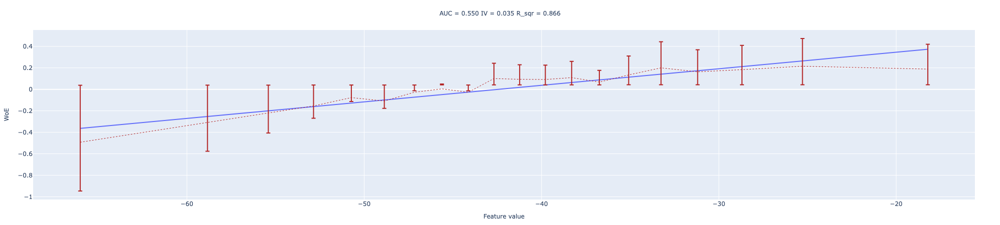

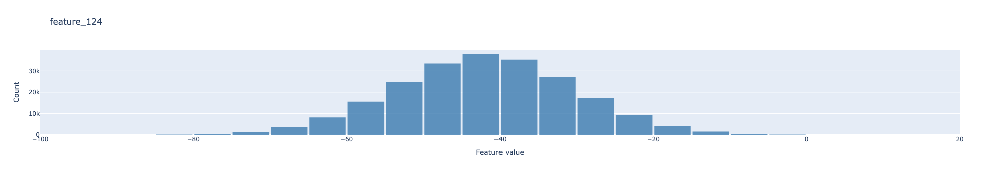

In [159]:
plot_woe_and_distribution(df_for_logreg, 'feature_124')

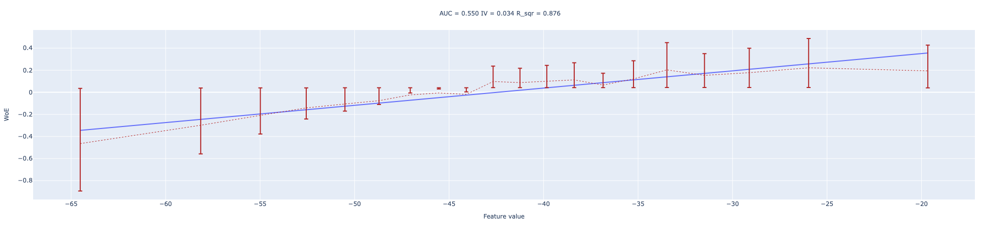

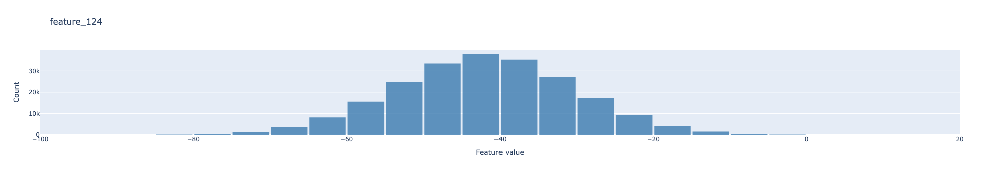

In [157]:
lo, hi = s.quantile([0.01, 0.99])
s_clip = s.clip(lo, hi)
m = s_clip.notna() & y.notna()
woe_line(values=s_clip[m], target=y[m], n_buckets=20).show()
fig_dist = go.Figure()
fig_dist.add_trace(
    go.Histogram(
        x=s[m],
        nbinsx=50,
        marker=dict(color='steelblue'),
        opacity=0.85,
        name='distribution'
    )
)
fig_dist.update_layout(
    title=f'{f}',
    xaxis_title='Feature value',
    yaxis_title='Count',
    width=1000,
    height=350,
    bargap=0.05
)
fig_dist.show()

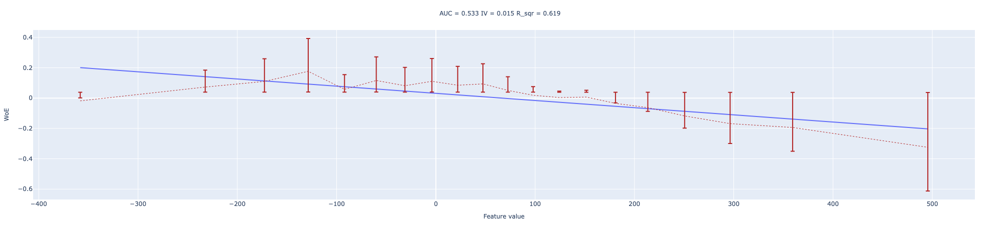

In [150]:
df_tr = df_for_logreg[df_for_logreg['sample_part'] == 'train']
f = 'feature_46'
s = df_tr[f]
y = df_tr['target']
m = s.notna() & y.notna()

woe_line(values=s[m], target=y[m], n_buckets=20).show()

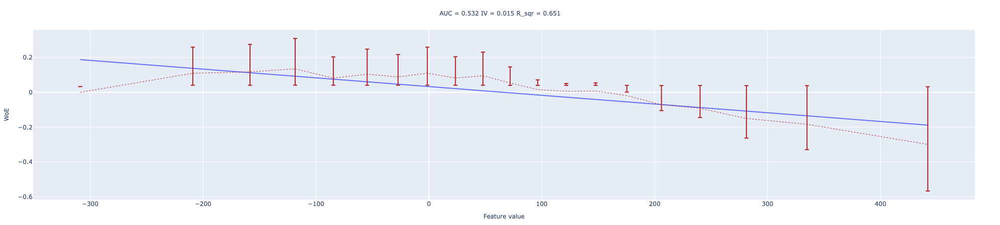

In [152]:
lo, hi = s.quantile([0.02, 0.98])
s_clip = s.clip(lo, hi)
m = s_clip.notna() & y.notna()
woe_line(values=s_clip[m], target=y[m], n_buckets=20)

Пришло время заполнить пропуски.

Самый простой вариант для числовых признаков - заполнить их средним значением фичи

**Вопрос**: какие проблемы могут возникнуть при таком заполнении пропусков?

**Задание**: Проверьте, что заполнение средним значением адекватно для тех признаков, где есть пропуски (hint: в нашем датасете - почти всегда адекватно). Если нет, придумайте, как ещё можно заполнить пропуски. Ну и заполните их)

In [19]:
# your code here

Вспомним про категориальные признаки, их нужно закодировать.

**Задание:** Используя `OneHotEncoder` закодируйте категориальные признаки.

In [ ]:
from sklearn.preprocessing import OneHotEncoder

# your code here

## Stepwise и обучение логрега (4 балла)

**Задание (boss)**: Реализуйте Stepwise-алгоритм.

Ваша функция `stepwise` должна принимать на вход:
- Датафрейм со всеми признаками и таргетом
- список с именами рассматриваемых признаков
- строку-имя таргета
- уровни значимости `alpha_in` и `alpha_out`

И возвращать список отобранных признаков.

Во время работы пусть она также выводит, какой признак был включён или исключён и с каким `p-value`

In [ ]:
from scipy.stats.distributions import chi2
from sklearn.metrics import log_loss

In [ ]:
def likelihood_ratio_test(ll_short, ll_long):
    
    """
    вспомогательная функция
    рассчитывает значение p-value для теста отношения правдоподобия
    ll_short — логарифм правдоподобия модели на k переменных
    ll_long — логарифм правдоподобия модели на k+1 переменной

    Returns
    -----
    p-value
    """
    lr = 2 * (ll_short - ll_long)
    return chi2.sf(lr, 1)

In [ ]:
def stepwise(
        df: pd.DataFrame, 
        features: list[str], 
        target: str, 
        alpha_in: float = 0.01, 
        alpha_out:  float = 0.05
        ) -> list[str]:
    

    selected_features = list()

    while True:

        # forward:
        best_feature = None
        if (len(selected_features) < len(features)):


            # your code here


            if best_feature:
                selected_features.append(best_feature)
                print(f"В модель была добавлена переменная {best_feature}, p-value: {round(p_value, 6)}")


        # backward
        worst_feature = None
        if (len(selected_features) > 1):


            # your code here


            if worst_feature:
                selected_features.remove(worst_feature)
                print(f"Из модели была удалена переменная {worst_feature}, p-value: {round(p_value, 6)}")

        if not (best_feature or worst_feature):
            break # но вы можете сформулировать критерий останова по-другому, если вам так будет удобнее писать

    return selected_features

Запустите ваш алгоритм на отобранных фичах со значениями `alpha_in = 0.01`, `alpha_out = 0.02`

Если в степвайз заходят *все переменные*, причём с очень маленькими `p-value` - это неудивительно, ведь вы уже провели серьёзный предварительный отбор фичей.

Чтобы убедиться в коректности работы своего алгоритма, можете попробовать запустить его на каких-нибудь других фичах, откинутых сильно ранее

In [ ]:
selected_features = stepwise(..., ..., ..., alpha_in = 0.01, alpha_out = 0.02)

**Задание**: На получившемся наборе признаков обучим, наконец, логрег!

Для обучения можно использовать трейн + валидацию вместе, либо просто трейн

*Не забудьте отскалировать фичи*

In [ ]:
from sklearn.preprocessing import StandardScaler # Или другой скейлер
from sklearn.linear_model import LogisticRegression
from scipy.special import logit

In [ ]:
scaler = StandardScaler()
scaler.fit(...)
# your code here
logreg = LogisticRegression(penalty=None)
logreg.fit(...)
df_for_logreg['logreg'] = logreg.predict_proba(...)[:, 1]
df_for_logreg['logit_logreg'] = logit(df_for_logreg['logreg'])

**Задание:** Оцените качество получившегося логрега **на тестовой выборке** по метрике `roc_auc`. 

**Ваша задача - побить** `threshold_auc = 0.622`. Если этого сделать ну совсем не получается, попробуйте добавить в модель ещё переменных (но должно получаться :)

**Также:**

- Постройте графики линейности по WoE получившегося логрега на трейне и тестовой выборке (оценивайте линейность для `logit_logreg`, а не для вероятности!)
- Постройте график стабильности `roc_auc` во времени для получившегося логрега

In [ ]:
# your code here

**Задание:** Визуализируйте важность фичей полученной линейной модели.

In [ ]:
# your code here

# Бонусная часть (до 5 баллов)

В разделе про бустинг мы обучали `LGBMClassifier` на довольно большом наборе фичей. Их количество можно сократить, при этом не теряя в качестве модели.

За начальный набор признаков можно взять все признаки (все 230) или признаки после отбора по IV.

**Ваша задача:** Отобрать признаки, подобрать оптимальные гиперпараметры и обучить `LGBMClassifier`.

Задание творческое) Можно использовать любые методы отбора признаков / оптимизации гиперпараметров.

**Чем меньше признаков, без ухудшения качества модели – тем лучше.**

In [ ]:
# your code here

Идеи для отбора признаков:

- Воспользоваться методами из модуля `sklearn.feature_selection` (точно можно попробовать RFE). Документация https://scikit-learn.org/stable/modules/feature_selection.html
- С помощью `BorutaPy` из библиотеки `boruta` (https://towardsdatascience.com/simple-example-using-boruta-feature-selection-in-python-8b96925d5d7a – статья может помочь разобраться с запуском алгоритма (мб не откроется без vpn))

In [ ]:
# your answere here